In [1]:
import pandas as pd
from PIL import Image, ImageDraw, ImageFont
import glob
import os

import random

In [2]:
def concat_image(images,nrows, ncols):
    width = 128
    height = 128
    
    background = Image.new('RGBA',(128*ncols, 128*nrows), (255, 255, 255, 255))
    bg_w, bg_h = background.size
    
    for i,image in enumerate(images):
    #print(i)
        img = image
        draw = ImageDraw.Draw(img, "RGB")
        #font = ImageFont.truetype("/Library/Fonts/Arial.ttf",50)
        #draw.text((50, 50), str(i),)
        start_X = i%ncols * 128
        start_Y = i//ncols * 128
        offset = (start_X,start_Y,start_X+width,start_Y+height)
        background.paste(img,offset)
        
    return background

In [3]:
userstudy = pd.read_csv('./userstudy.csv')
userstudy

,brown_nosmile_C,blond_smile_S,ours_AB
0,001645.jpg,001193.jpg,001645001193.jpg
1,000398.jpg,001567.jpg,000398001567.jpg
2,000389.jpg,001979.jpg,000389001979.jpg
3,000215.jpg,000317.jpg,000215000317.jpg
4,000445.jpg,000510.jpg,000445000510.jpg
5,000862.jpg,000013.jpg,000862000013.jpg
6,001821.jpg,000029.jpg,001821000029.jpg
7,000373.jpg,001576.jpg,000373001576.jpg
8,000855.jpg,000485.jpg,000855000485.jpg
9,001702.jpg,001658.jpg,001702001658.jpg


### A, B, our, drit, munit, real

In [4]:
dritdir = './userstudy_data/drit/'
munitdir = './userstudy_data/munit/'
cdgan = './userstudy_data/cdgan/'
ours = './userstudy_data/ours/'
blond = './userstudy_data/blond_smile/'
brown = './userstudy_data/brown_nosmile/'

In [5]:
real = glob.glob('./userstudy_data/real/*')

In [6]:
rows = []
for i, row in userstudy.iterrows():
    print(row)
    afile = row['brown_nosmile_C']
    bfile = row['blond_smile_S']
    abfile = row['ours_AB']
    
    A = Image.open(brown+afile)
    B = Image.open(blond+bfile)

    AB_ours = Image.open(ours+abfile)
    AB_drit = Image.open(dritdir+abfile)
    AB_munit = Image.open(munitdir+abfile)
    AB_cdgan = Image.open(cdgan+abfile)
    real_image = Image.open(real[i])
    rows += [A,B,AB_ours,AB_drit,AB_munit,AB_cdgan,real_image]

brown_nosmile_C          001645.jpg
blond_smile_S            001193.jpg
ours_AB            001645001193.jpg
Name: 0, dtype: object
brown_nosmile_C          000398.jpg
blond_smile_S            001567.jpg
ours_AB            000398001567.jpg
Name: 1, dtype: object
brown_nosmile_C          000389.jpg
blond_smile_S            001979.jpg
ours_AB            000389001979.jpg
Name: 2, dtype: object
brown_nosmile_C          000215.jpg
blond_smile_S            000317.jpg
ours_AB            000215000317.jpg
Name: 3, dtype: object
brown_nosmile_C          000445.jpg
blond_smile_S            000510.jpg
ours_AB            000445000510.jpg
Name: 4, dtype: object
brown_nosmile_C          000862.jpg
blond_smile_S            000013.jpg
ours_AB            000862000013.jpg
Name: 5, dtype: object
brown_nosmile_C          001821.jpg
blond_smile_S            000029.jpg
ours_AB            001821000029.jpg
Name: 6, dtype: object
brown_nosmile_C          000373.jpg
blond_smile_S            001576.jpg
ours_AB    

brown_nosmile_C          000890.jpg
blond_smile_S            000579.jpg
ours_AB            000890000579.jpg
Name: 79, dtype: object
brown_nosmile_C          001223.jpg
blond_smile_S            000334.jpg
ours_AB            001223000334.jpg
Name: 80, dtype: object
brown_nosmile_C          001554.jpg
blond_smile_S            001475.jpg
ours_AB            001554001475.jpg
Name: 81, dtype: object
brown_nosmile_C          001910.jpg
blond_smile_S            000822.jpg
ours_AB            001910000822.jpg
Name: 82, dtype: object
brown_nosmile_C          001495.jpg
blond_smile_S            001050.jpg
ours_AB            001495001050.jpg
Name: 83, dtype: object
brown_nosmile_C          001530.jpg
blond_smile_S            001899.jpg
ours_AB            001530001899.jpg
Name: 84, dtype: object
brown_nosmile_C          000067.jpg
blond_smile_S            000523.jpg
ours_AB            000067000523.jpg
Name: 85, dtype: object
brown_nosmile_C          000469.jpg
blond_smile_S            000588.jpg
ours

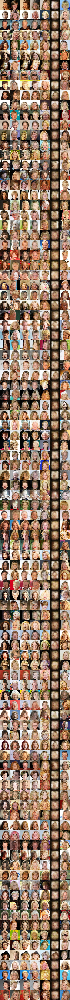

In [7]:
concat_image(rows,100, 7)